In [1]:
import scanpy as sc 
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr
from scipy.stats import spearmanr
import matplotlib.patches as mpatches

from scipy.stats import mannwhitneyu
import itertools

In [2]:
import json

with open('colors.json', 'r') as f:
    color_dict = json.load(f)

In [3]:
import sys 
sys.path.append('../../src')

from spaceoracle.oracles import BaseTravLR
from spaceoracle.plotting.cartography import Cartography


In [4]:
adata_control = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_lymph1_visiumHD.h5ad')
adata_ko = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_lymphKO4_visiumHD.h5ad')
adata_ko2 = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_lymphKO2_visiumHD.h5ad')


In [5]:
transferred = np.loadtxt('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/degs_lymph1_transferred.txt', dtype=str)
ko_transferred = np.loadtxt('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/degs_lymphKO4_transferred.txt', dtype=str)
ko2_transferred = np.loadtxt('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/degs_lymphKO2_transferred.txt', dtype=str)

# Remove the Tregs from the transferred list since the correct proportion is low

transferred = [cell for cell in transferred if adata_control.obs.loc[cell, 'cell_type'] != 'Treg']
ko_transferred = [cell for cell in ko_transferred if adata_ko.obs.loc[cell, 'cell_type'] != 'Treg']
ko2_transferred = [cell for cell in ko2_transferred if adata_ko2.obs.loc[cell, 'cell_type'] != 'Treg']

len(transferred), len(ko_transferred), len(ko2_transferred)

(176, 172, 198)

In [6]:
adata_control.X = adata_control.layers['normalized_count']
adata_ko.X = adata_ko.layers['normalized_count']
adata_ko2.X = adata_ko2.layers['normalized_count']

adata_control.obs['tissue'] = 'lymph1'
adata_ko.obs['tissue'] = 'lymphKO4'
adata_ko2.obs['tissue'] = 'lymphKO2'

In [7]:
lymph1_banksy_df = pd.read_csv('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/lymph1_visiumHD_banksy_annotated_zones.csv', index_col=0)
lymphko2_banksy_df = pd.read_csv('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/lymphKO2_visiumHD_banksy_annotated_zones.csv', index_col=0)
lymphko4_banksy_df = pd.read_csv('/ix/djishnu/alw399/SpaceOracle/notebooks/mouse_lymphnode_visiumHD/lymphKO4_visiumHD_banksy_annotated_zones.csv', index_col=0)

lymph1_banksy_df.index = lymph1_banksy_df.index.astype(str)
lymphko2_banksy_df.index = lymphko2_banksy_df.index.astype(str)
lymphko4_banksy_df.index = lymphko4_banksy_df.index.astype(str)


In [8]:
adata_control.obs['banksy_cluster'] = lymph1_banksy_df['banksy_cluster']
adata_ko.obs['banksy_cluster'] = lymphko4_banksy_df['banksy_cluster']
adata_ko2.obs['banksy_cluster'] = lymphko2_banksy_df['banksy_cluster']

adata_control.obs['1DER_cell_type'] = np.where(adata_control.obs.index.isin(transferred), adata_control.obs['cell_type'], 'NA')
adata_ko.obs['1DER_cell_type'] = np.where(adata_ko.obs.index.isin(ko_transferred), adata_ko.obs['cell_type'], 'NA')
adata_ko2.obs['1DER_cell_type'] = np.where(adata_ko2.obs.index.isin(ko2_transferred), adata_ko2.obs['cell_type'], 'NA')

adata_control.obs['1DER_cell_type'] = '1DER ' + adata_control.obs['1DER_cell_type'].astype(str)
adata_ko.obs['1DER_cell_type'] = '1DER ' + adata_ko.obs['1DER_cell_type'].astype(str)
adata_ko2.obs['1DER_cell_type'] = '1DER ' + adata_ko2.obs['1DER_cell_type'].astype(str)


In [9]:
from scipy.spatial import cKDTree

def get_b_neighbors(adata, radius=30, use_1der=False):
    # b_idx = adata.obs_names[adata.obs['cell_type'] == 'B']
    # b_coords = adata[adata.obs['cell_type'] == 'B'].obsm['spatial']

    b_idx = adata.obs_names[adata.obs['cell_type'] == 'CD8+ T']
    b_coords = adata[adata.obs['cell_type'] == 'CD8+ T'].obsm['spatial']
    
    # b_idx = adata.obs_names
    # b_coords = adata.obsm['spatial']

    if use_1der:
        t_idx = adata.obs_names[adata.obs['1DER_cell_type'] == '1DER Th2']
        t_coords = adata[adata.obs['1DER_cell_type'] == '1DER Th2'].obsm['spatial']
    else:
        t_idx = adata.obs_names[adata.obs['cell_type'] == 'Th2']
        t_coords = adata[adata.obs['cell_type'] == 'Th2'].obsm['spatial']
        

    b_tree = cKDTree(b_coords)

    b_near_t = {}
    for i, (t_name, t_coord) in enumerate(zip(t_idx, t_coords)):
        idxs = b_tree.query_ball_point(t_coord, r=radius)
        b_near_t[t_name] = list(b_idx[idxs])

    return b_near_t

def get_bdata(adata, radius=30):

    b_near_t = get_b_neighbors(adata, radius)

    gex_df = adata.to_df(layer='normalized_count')

    b_neighbors = {}
    for cell, gex in b_near_t.items():
        b_neighbors[cell] = gex_df.loc[b_near_t[cell]].mean()

    b_neighbors = pd.DataFrame(b_neighbors).T

    b_neighbors = sc.AnnData(
        X = b_neighbors.values,
        obs = adata.obs.loc[b_neighbors.index],
        var = pd.DataFrame(index=b_neighbors.columns)
    )

    b_neighbors.X = np.nan_to_num(b_neighbors.X, nan=0)

    # 1DER Th2: transferred
    # 1DER NA: polyclonal

    sc.tl.rank_genes_groups(
        b_neighbors,
        groupby='1DER_cell_type',
        method='wilcoxon',
        use_raw=False, 
        reference='1DER NA'
    )

    degs = sc.get.rank_genes_groups_df(b_neighbors, group='1DER Th2')
    return degs


In [10]:
degs_ko2 = get_bdata(adata_ko2)
degs_ko4 = get_bdata(adata_ko)
degs_control = get_bdata(adata_control)

degs = pd.merge(degs_ko2, degs_ko4, on='names', how='outer', suffixes=('_2', '_4'))
degs = pd.merge(degs, degs_control, on='names', how='outer', suffixes=('ko', '_control'))

degs

,names,scores_2,logfoldchanges_2,pvals_2,pvals_adj_2,scores_4,logfoldchanges_4,pvals_4,pvals_adj_4,scores,logfoldchanges,pvals,pvals_adj
0,Adam11,-0.074587,-0.496062,0.940543,1.0,0.506977,2.169681,0.612171,1.0,-0.398878,-1.500077,0.689983,1.0
1,Adam12,0.023027,-0.396615,0.981629,1.0,0.164394,1.414448,0.869421,1.0,-0.232177,-0.350669,0.816401,1.0
2,Adam23,0.062072,-0.151078,0.950505,1.0,0.174166,-0.503058,0.861735,1.0,-0.655960,-0.936503,0.511850,1.0
3,Adam8,-0.104122,-0.510768,0.917073,1.0,0.151748,0.076593,0.879385,1.0,0.092389,0.036024,0.926389,1.0
4,Adamts10,1.602871,1.119115,0.108963,1.0,0.199457,-0.123358,0.841905,1.0,0.841541,0.513344,0.400045,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2111,Zmynd12,0.000000,0.000000,1.000000,1.0,0.000000,0.000000,1.000000,1.0,0.000000,0.000000,1.000000,1.0
2112,Zmynd15,0.129151,-0.452281,0.897238,1.0,0.455245,0.544415,0.648933,1.0,-0.935938,-0.804922,0.349305,1.0
2113,Znfx1,0.402970,0.832022,0.686970,1.0,0.286252,0.581134,0.774685,1.0,0.365136,0.612113,0.715010,1.0
2114,Znhit2,-0.001502,-0.078948,0.998802,1.0,0.264985,0.935963,0.791021,1.0,-0.191204,-0.871996,0.848365,1.0


In [11]:
degs['scores_ko'] = degs['scores_2'] + degs['scores_4']
degs['logfoldchanges_ko'] = degs['logfoldchanges_2'] + degs['logfoldchanges_4']

degs.sort_values(by='scores_ko', ascending=False, inplace=True)

In [12]:
degs = degs[
    ((degs['logfoldchanges_2'] > 0) & (degs['logfoldchanges_4'] > 0)) 
    | ((degs['logfoldchanges_2'] < 0) & (degs['logfoldchanges_4'] < 0))
]
degs['logfoldchanges_ko_min'] = degs[['logfoldchanges_2', 'logfoldchanges_4']].min(axis=1)
degs['logfoldchanges_ko_max'] = degs[['logfoldchanges_2', 'logfoldchanges_4']].max(axis=1)

In [13]:
# top_5 = degs[degs['logfoldchanges_ko'] > 0].sort_values(by='logfoldchanges_ko', ascending=False)
# bottom_5 = degs[degs['logfoldchanges_ko'] < 0].sort_values(by='logfoldchanges_ko', ascending=True)

In [14]:
top_5 = degs[
    (degs['logfoldchanges_ko'] > 0) & (degs['logfoldchanges_ko_min'] > degs['logfoldchanges'] +0.1)
].sort_values(by='scores_ko', ascending=False)

bottom_5 = degs[
    (degs['logfoldchanges_ko'] < 0) & (degs['logfoldchanges_ko_max'] < degs['logfoldchanges'] -0.1)
].sort_values(by='scores_ko', ascending=True)

In [15]:
def get_consistent_degs(adata_control, adata_ko, adata_ko2, top_5, bottom_5, use_1der=False):

    b_control = get_b_neighbors(adata_control, use_1der=use_1der)
    b_ko = get_b_neighbors(adata_ko, use_1der=use_1der)
    b_ko2 = get_b_neighbors(adata_ko2, use_1der=use_1der)

    b_control = sc.concat([adata_control[v, :] for k, v in b_control.items()], axis=0)
    b_ko = sc.concat([adata_ko[v, :] for k, v in b_ko.items()], axis=0)
    b_ko2 = sc.concat([adata_ko2[v, :] for k, v in b_ko2.items()], axis=0)

    adata_b = sc.AnnData(
        X = np.concatenate([b_control.X, b_ko.X, b_ko2.X], axis=0),
        var = b_control.var,
        obs = pd.concat([b_control.obs, b_ko.obs, b_ko2.obs], axis=0)
    )

    sc.tl.rank_genes_groups(adata_b, groupby='tissue', method='wilcoxon', use_raw=False, reference='lymph1')
    degs_ko4 = sc.get.rank_genes_groups_df(adata_b, group='lymphKO4')   
    degs_ko2 = sc.get.rank_genes_groups_df(adata_b, group='lymphKO2')

    degs_consistent = pd.merge(degs_ko4, degs_ko2, on='names', how='inner', suffixes=('_ko4', '_ko2'))
    degs_consistent = degs_consistent[degs_consistent['logfoldchanges_ko4'] * degs_consistent['logfoldchanges_ko2'] > 0]
    top_5_consistent = degs_consistent[degs_consistent['names'].isin(top_5['names'])]
    top_5_consistent = top_5_consistent[top_5_consistent['logfoldchanges_ko4'] > 0]
    top_5_consistent['scores_ko'] = top_5_consistent['scores_ko4'] + top_5_consistent['scores_ko2']

    bottom_5_consistent = degs_consistent[degs_consistent['names'].isin(bottom_5['names'])]
    bottom_5_consistent = bottom_5_consistent[bottom_5_consistent['logfoldchanges_ko4'] < 0]
    bottom_5_consistent['scores_ko'] = bottom_5_consistent['scores_ko4'] + bottom_5_consistent['scores_ko2']

    top_5_consistent = top_5_consistent[top_5_consistent['names'].isin(top_5['names'])]
    bottom_5_consistent = bottom_5_consistent[bottom_5_consistent['names'].isin(bottom_5['names'])]

    return top_5_consistent, bottom_5_consistent


In [16]:
top_5_all, bottom_5_all = get_consistent_degs(adata_control, adata_ko, adata_ko2, top_5.copy(), bottom_5.copy())
top_5_1der, bottom_5_1der = get_consistent_degs(adata_control, adata_ko, adata_ko2, top_5.copy(), bottom_5.copy(), use_1der=True)

/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/anndata/_core/anndata.py:1754: UserWarning: Observat

In [17]:
top_5_all

,names,scores_ko4,logfoldchanges_ko4,pvals_ko4,pvals_adj_ko4,scores_ko2,logfoldchanges_ko2,pvals_ko2,pvals_adj_ko2,scores_ko
1,Il7r,2.037727,0.921393,0.041577,1.0,3.779335,0.678499,1.572480e-04,7.562199e-03,5.817061
2,Inpp4b,1.717309,0.334377,0.085923,1.0,6.831027,0.706557,8.430900e-12,2.229973e-09,8.548336
5,Selenom,1.284826,1.210907,0.198853,1.0,0.351597,0.355874,7.251408e-01,1.000000e+00,1.636423
10,Il15ra,1.190084,1.278462,0.234013,1.0,1.063938,0.551831,2.873566e-01,1.000000e+00,2.254022
18,Dusp2,1.028935,0.586937,0.303510,1.0,3.603720,0.931587,3.136946e-04,1.377306e-02,4.632656
...,...,...,...,...,...,...,...,...,...,...
1095,Trim65,-0.124756,0.305459,0.900717,1.0,0.912826,0.675274,3.613340e-01,1.000000e+00,0.788070
1194,Cdc42ep3,-0.176861,0.051345,0.859618,1.0,0.904939,0.081193,3.654976e-01,1.000000e+00,0.728078
1203,Cbx7,-0.181024,0.118066,0.856349,1.0,0.894213,0.164571,3.712079e-01,1.000000e+00,0.713189
1326,Med20,-0.247229,0.016039,0.804731,1.0,2.057999,0.917560,3.959019e-02,5.138786e-01,1.810770


In [18]:
top = pd.merge(top_5_all, top_5_1der, on='names', how='outer', suffixes=('_all', '_1der'))
top['pvals_min'] = top[['pvals_ko2_1der', 'pvals_ko4_1der', 'pvals_ko2_all', 'pvals_ko4_all']].min(axis=1)
top.sort_values(by='pvals_min', ascending=True, inplace=True)
top.head(20)['names'].tolist()


['Inpp4b',
 'Il7r',
 'Kbtbd11',
 'Dusp2',
 'Dtx3l',
 'Igfbp4',
 'Atp1a1',
 'Sun2',
 'Fnbp4',
 'Utrn',
 'Ctsw',
 'Paxbp1',
 'Med20',
 'Atp5e',
 'Aif1',
 'Vgll4',
 'Impdh1',
 'Emb',
 'Ppp3cc',
 'Gata3']

In [19]:
bottom = pd.merge(bottom_5_all, bottom_5_1der, on='names', how='outer', suffixes=('_all', '_1der'))
bottom['pvals_max'] = bottom[['pvals_ko2_1der', 'pvals_ko4_1der', 'pvals_ko2_all', 'pvals_ko4_all']].min(axis=1)
bottom.sort_values(by='pvals_max', ascending=True, inplace=True)
bottom.head(20)['names'].tolist()

['Cd79b',
 'Syk',
 'Cst3',
 'Iglc3',
 'Cxcr5',
 'Ccr6',
 'Stap1',
 'Rab8b',
 'Dnase1l3',
 'Csf1r',
 'Atp8b2',
 'Cd72',
 'Sh2d1a',
 'Plec',
 'Hist1h1b',
 'Zbp1',
 'Hhex',
 'Ifnar1',
 'Katna1',
 'Akip1']

In [ ]:
top.to_csv('top_5_all_vs_1der.csv', index=False)
bottom.to_csv('bottom_5_all_vs_1der.csv', index=False)

In [20]:
'''
selection of these genes based on many criteria:
1a. neighborhood averaged gex logfc between 1DER vs polyclonal in each sample
1b. logfoldchanges_ko4 and ko2 for 1DER vs polyclonal > control
2. degs between 1DER control and 1DER KOs
3. consistent direction in all comparisons
4. consistent tissue-wise comparison using 1DER and all Th2 cells
'''

'\nselection of these genes based on many criteria:\n1a. neighborhood averaged gex logfc between 1DER vs polyclonal in each sample\n1b. logfoldchanges_ko4 and ko2 for 1DER vs polyclonal > control\n2. degs between 1DER control and 1DER KOs\n3. consistent direction in all comparisons\n4. consistent tissue-wise comparison using 1DER and all Th2 cells\n'

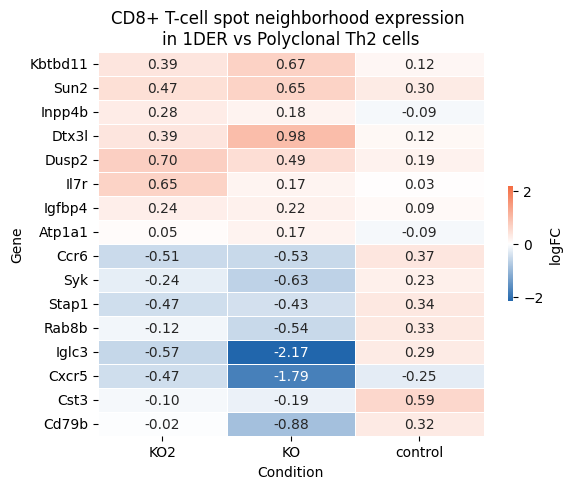

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Create a blue-white-orange colormap
blue_orange_cmap = LinearSegmentedColormap.from_list(
    'blue_orange', 
    ['#2166ac', 'white', '#f46d43']  # blue → white → orange
)

# Your existing code to generate the heatmap data
selected_degs = pd.concat([
    top_5[top_5['names'].isin(top.head(8)['names'].tolist())], 
    bottom_5[bottom_5['names'].isin(bottom.head(8)['names'].tolist())]
])

relabel = {
    'logfoldchanges_2': 'KO2',
    'logfoldchanges_4': 'KO',
    'logfoldchanges': 'control'
}

# Prepare heatmap data for logfoldchanges
heatmap_data = selected_degs.set_index('names')[['logfoldchanges_2', 'logfoldchanges_4', 'logfoldchanges']]
heatmap_data.columns = [relabel.get(col, col) for col in heatmap_data.columns]

# Prepare annotation data with logfoldchange
def make_annot(row):
    return [
        f"{row['logfoldchanges_2']:.2f}",
        f"{row['logfoldchanges_4']:.2f}",
        f"{row['logfoldchanges']:.2f}"
    ]

annot_data = selected_degs.apply(make_annot, axis=1, result_type='expand')
annot_data.index = selected_degs['names']
annot_data.columns = heatmap_data.columns

# Calculate max value for color scaling
max_abs = np.abs(heatmap_data.values).max()
vmax = min(max_abs, 3)

# Create the heatmap with the custom colormap
plt.figure(figsize=(6, 5))
sns.heatmap(
    heatmap_data,
    annot=annot_data.values,
    fmt='',
    cmap=blue_orange_cmap,  # Use the custom colormap
    center=0,
    linewidths=0.5,
    vmin=-vmax,
    vmax=vmax,
    cbar_kws={'label': 'logFC', 'shrink': 0.3},
)

# Add labels and title
plt.xlabel('Condition')
plt.ylabel('Gene')
plt.title('CD8+ T-cell spot neighborhood expression \nin 1DER vs Polyclonal Th2 cells')

# Save and show the plot
plt.tight_layout()
plt.savefig('figures/cd8_neighborhood_expression_1der_vs_polyclonal_th2.svg', dpi=300, transparent=True, bbox_inches='tight', format='svg')
plt.show()


In [60]:
top_genes = top.head(8)['names'].tolist()
bottom_genes = bottom.head(8)['names'].tolist()

top_genes, bottom_genes


(['Inpp4b', 'Il7r', 'Kbtbd11', 'Dusp2', 'Dtx3l', 'Igfbp4', 'Atp1a1', 'Sun2'],
 ['Cd79b', 'Syk', 'Cst3', 'Iglc3', 'Cxcr5', 'Ccr6', 'Stap1', 'Rab8b'])

/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:176: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[score_name] = pd.Series(


[<Axes: title={'center': 'top5_score'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'bottom5_score'}, xlabel='spatial1', ylabel='spatial2'>]

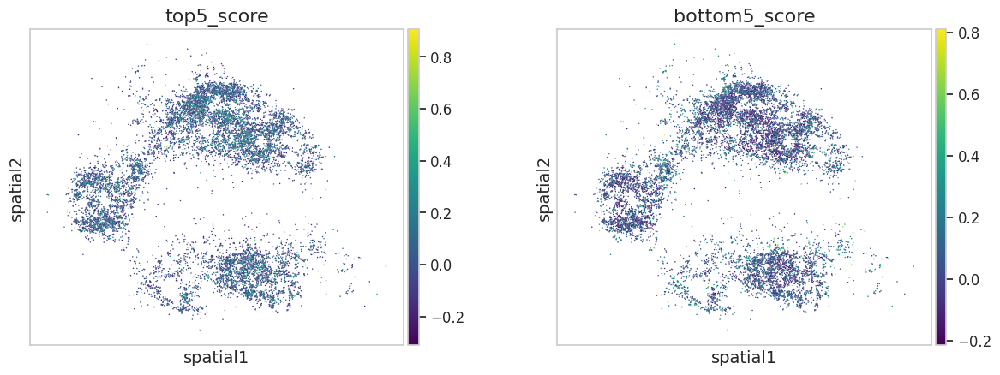

In [61]:
cd8_adata = adata_control[adata_control.obs['cell_type'] == 'CD8+ T']

sc.tl.score_genes(cd8_adata, gene_list=top_genes, score_name='top5_score', use_raw=False)
sc.tl.score_genes(cd8_adata, gene_list=bottom_genes, score_name='bottom5_score', use_raw=False)

sc.pl.spatial(cd8_adata, color=['top5_score', 'bottom5_score'], show=False, spot_size=20, layer='normalized_count', cmap='viridis')

In [62]:
import squidpy as sq
sq.gr.spatial_neighbors(cd8_adata)
top_moran = sq.gr.spatial_autocorr(cd8_adata, mode='moran', genes=top_genes, n_perms=100, copy=True)
bottom_moran = sq.gr.spatial_autocorr(cd8_adata, mode='moran', genes=bottom_genes, n_perms=100, copy=True)

  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

/tmp/ipykernel_77462/916763853.py:37: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


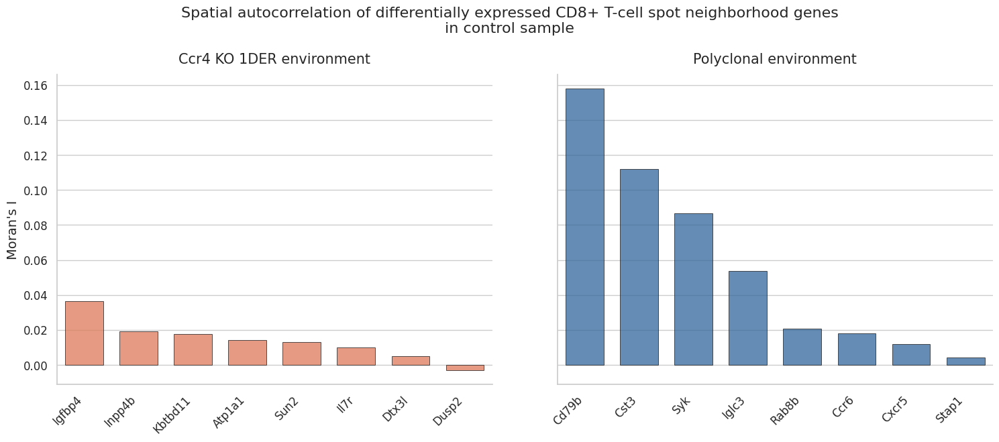

In [63]:
sns.set(style="whitegrid", font_scale=1.2)
plt.rcParams.update({'axes.titlesize': 16, 'axes.labelsize': 14, 'xtick.labelsize': 12, 'ytick.labelsize': 12})

top_moran_I = top_moran['I'].values
bottom_moran_I = bottom_moran['I'].values

x = np.arange(len(top_moran.index))

fig, axs = plt.subplots(1, 2, figsize=(18, 6), sharey=True, gridspec_kw={'wspace': 0.15})

bar_kwargs = dict(width=0.7, edgecolor='k', linewidth=0.7)

# Top genes barplot
sns.barplot(x=x, y=top_moran_I, ax=axs[0], color='#f46d43', alpha=0.75, **bar_kwargs)
axs[0].set_xticks(x)
axs[0].set_xticklabels(top_moran.index, rotation=45, ha='right')
axs[0].set_ylabel("Moran's I", fontsize=14)
axs[0].set_title("Ccr4 KO 1DER environment", fontsize=15, pad=12)
axs[0].spines['top'].set_visible(False)
axs[0].spines['right'].set_visible(False)

# Bottom genes barplot
sns.barplot(x=x, y=bottom_moran_I, ax=axs[1], color='#2166ac', alpha=0.75, **bar_kwargs)
axs[1].set_xticks(x)
axs[1].set_xticklabels(bottom_moran.index, rotation=45, ha='right')
axs[1].set_title("Polyclonal environment", fontsize=15, pad=12)
axs[1].spines['top'].set_visible(False)
axs[1].spines['right'].set_visible(False)
axs[1].set_ylabel("")

# for i, v in enumerate(top_moran_I):
#     axs[0].text(i, v + 0.001, f"{v:.2f}", ha='center', va='bottom', fontsize=10, color='#333333')
# for i, v in enumerate(bottom_moran_I):
#     axs[1].text(i, v + 0.001, f"{v:.2f}", ha='center', va='bottom', fontsize=10, color='#333333')

plt.suptitle("Spatial autocorrelation of differentially expressed CD8+ T-cell spot neighborhood genes\nin control sample", fontsize=16, y=1.05)
plt.tight_layout()
plt.savefig('figures/cd8_moran_1der_vs_polyclonal.png', dpi=300)
plt.show()


In [91]:
import scanpy as sc 

adata_sc = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/rctd_outputs/mouse_lymphnode_slideseq/zhongli_ref_202401203_mannually_woDoublet.h5ad')

sc.tl.rank_genes_groups(adata_sc, groupby="cell_type", use_raw=False)
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:50, :]
# markers = markers_df['CD8+ T'].values.flatten()
# markers = markers_df[['Th2','B']].values.flatten()
markers = np.unique(markers_df.values.flatten())
len(markers)

318

In [92]:
# target_genes = ['Il2ra', 'Gata3', 'Il4']
target_genes = [x for x in markers if x in adata_control.var_names]
len(target_genes)

161

In [93]:
import os 

betadir = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/'

data = {}
for gene in target_genes:
    dfs = []
    for sample in ['a', 'b', 'c', 'd']:
        fpath = os.path.join(betadir, f'mouse_lymph1{sample}_visiumHD', f'{gene}_betadata.parquet')
        if os.path.exists(fpath):
            dfs.append(pd.read_parquet(fpath))
    if dfs:
        data[gene] = pd.concat(dfs, axis=0)
len(data.keys())

151

In [94]:
adata = adata_control

In [95]:
interactions = {
    'Th2': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'Th2'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'Th2_transferred': {
        gene: data[gene].reindex(adata[(adata.obs['cell_type'] == 'Th2') & (adata.obs.index.isin(transferred))].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'Cd4': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'].isin(['Th2','Tfh'])].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    }, 
    'B': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'B'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'all': {
        gene: data[gene].reindex(adata.obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'CD8+ T': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'CD8+ T'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
}

In [96]:
dfr = pd.concat([interactions['all'][g] for g in set(data.keys())], axis=1).fillna(0)
dfr = dfr.groupby(dfr.columns, axis=1).mean()
dfr = dfr[[x for x in dfr.columns if ('$' in x or '#' in x)]]
# dfr = dfr[[x for x in dfr.columns if ('$' in x)]]

dfr_ligands = [x.split('$')[0] if '$' in x else x.split('#')[0] if '#' in x else 'none' for x in dfr.columns]
dfr_ligands = [x.replace('beta_', '') for x in dfr_ligands]
dfr_genes = [x.split('$')[1] if '$' in x else x.split('#')[1] if '#' in x else 'none' for x in dfr.columns]

adata.uns['received_ligands']['none'] = 0 # for the beta_TF
adata.uns['cell_thresholds']['none'] = 0

ligands_expr = adata.uns['received_ligands'].loc[dfr.index, dfr_ligands]
ligands_expr = np.where(adata.uns['cell_thresholds'].loc[dfr.index, dfr_ligands] > 0, ligands_expr, 0)
receptors_expr = adata.to_df(layer='imputed_count').loc[dfr.index].reindex(dfr_genes, axis=1).fillna(0)
receptors_expr = np.where(adata.uns['cell_thresholds'].loc[dfr.index].reindex(dfr_genes, axis=1).fillna(0) > 0, receptors_expr, 0)

dfr = pd.DataFrame(
    dfr.values * ligands_expr * receptors_expr, 
    index=dfr.index, columns=dfr.columns
)
dfr.columns = [x.replace('$', '-').replace('beta_', '') for x in dfr.columns]


In [97]:
[x for x in dfr.columns if any(gene in x for gene in bottom_genes)]


['Cxcl13-Cxcr5']

In [98]:
[x for x in dfr.columns if any(gene in x for gene in top_genes)]

[]

[<Axes: title={'center': 'Cxcl13-Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>]

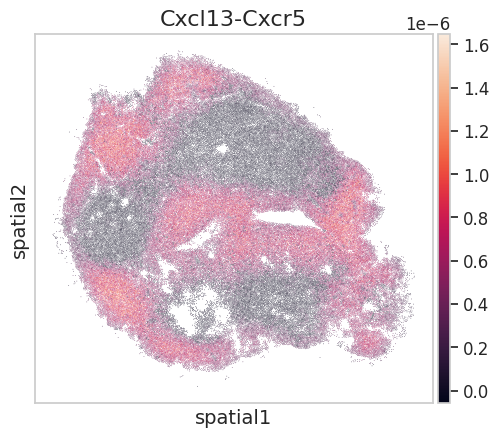

In [99]:
adata.obs['Cxcl13-Cxcr5'] = dfr['Cxcl13-Cxcr5']
import scanpy as sc
sc.pl.spatial(adata, color=['Cxcl13-Cxcr5'], show=False, spot_size=10)

In [100]:
dfr = dfr.drop(columns=['beta0'], errors='ignore')

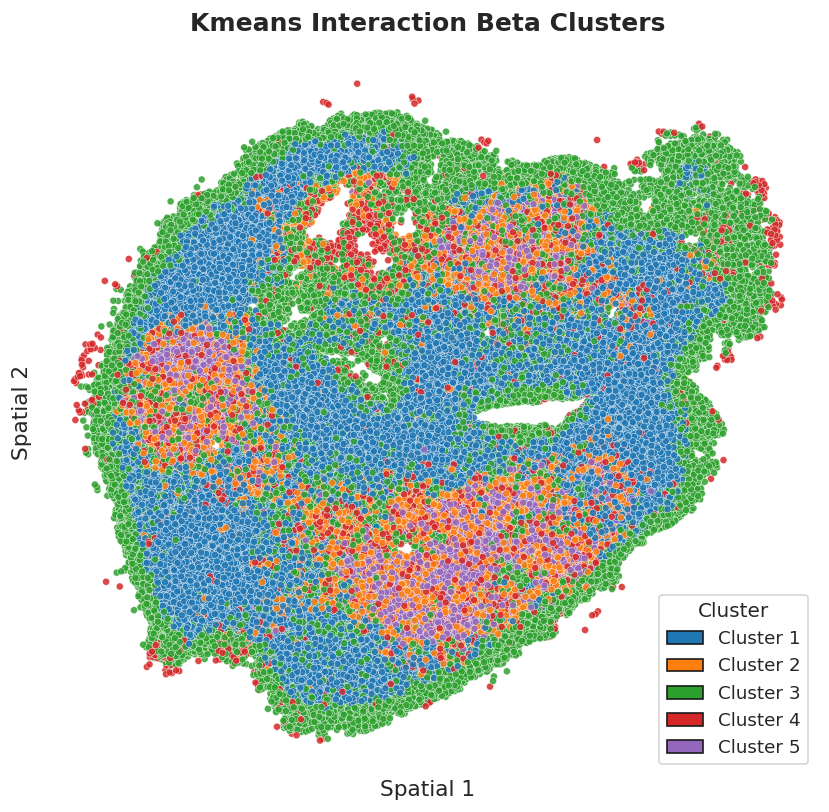

In [103]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from matplotlib.patches import Patch

# Add spatial coordinates to adata.obs if not already present
adata.obs['spatial1'] = adata.obsm['spatial'][:, 0]
adata.obs['spatial2'] = adata.obsm['spatial'][:, 1]

# Choose number of clusters
n_clusters = 5

# Run k-means clustering on dfr
kmeans = KMeans(n_clusters=n_clusters, random_state=0)
clusters = kmeans.fit_predict(dfr.values)

# Add cluster labels to adata.obs (aligning indices)
cluster_col = 'ST_cluster'
adata.obs[cluster_col] = pd.Series(clusters, index=dfr.index).astype(str)

# Define a pretty color palette
palette = sns.color_palette("tab10", n_clusters)
cluster_colors = {str(i): palette[i] for i in range(n_clusters)}

# Prepare colors for plotting
point_colors = adata.obs.loc[dfr.index, cluster_col].map(cluster_colors)

fig, ax = plt.subplots(figsize=(8, 7), dpi=120)
sc = ax.scatter(
    adata.obs.loc[dfr.index, 'spatial1'],
    adata.obs.loc[dfr.index, 'spatial2'],
    c=point_colors,
    s=18,
    edgecolor='w',
    linewidth=0.3,
    alpha=0.85
)

# Custom legend with pretty cluster colors
legend_elements = [
    Patch(facecolor=cluster_colors[str(i)], edgecolor='k', label=f"Cluster {i+1}")
    for i in range(n_clusters)
]
ax.legend(handles=legend_elements, title="Cluster", loc="best", frameon=True, fontsize=11, title_fontsize=12)

ax.set_xlabel('Spatial 1', fontsize=13)
ax.set_ylabel('Spatial 2', fontsize=13)
ax.set_title('Kmeans Interaction Beta Clusters', fontsize=15, weight='bold', pad=12)
sns.despine(ax=ax, left=True, bottom=True)
ax.grid(False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')

plt.tight_layout()
plt.show()


In [102]:
import gc 
gc.collect()

2645

In [72]:
# b_control = adata.obs.index[(adata.obs['banksy_cluster'].isin(['T cell zone'])) & (adata.obs['cell_type'] == 'B')]
# dfr = dfr.loc[b_control, :]
# dfr.shape

# dump

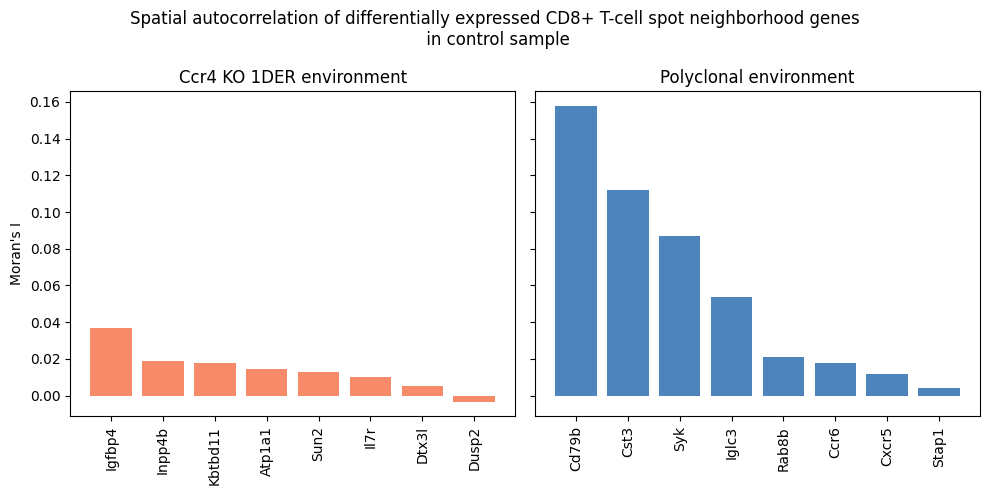

In [48]:
top_moran_I = top_moran['I'].values
bottom_moran_I = bottom_moran['I'].values

x = np.arange(len(top_moran.index))

fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

axs[0].bar(x, top_moran_I, color='#f46d43', alpha=0.8)
axs[0].set_xticks(x)
axs[0].set_xticklabels(top_moran.index, rotation=90)
axs[0].set_ylabel("Moran's I")
axs[0].set_title("Ccr4 KO 1DER environment")

axs[1].bar(x, bottom_moran_I, color='#2166ac', alpha=0.8)
axs[1].set_xticks(x)
axs[1].set_xticklabels(bottom_moran.index, rotation=90)
axs[1].set_title("Polyclonal environment")

plt.suptitle("Spatial autocorrelation of differentially expressed CD8+ T-cell spot neighborhood genes\n in control sample")
plt.tight_layout()
plt.show()


/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/squidpy/gr/_utils.py:194: ImplicitModificationWarning: Setting element `.obsp['spatial_connectivities']` of view, initializing view as actual.
  obj[key] = data


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

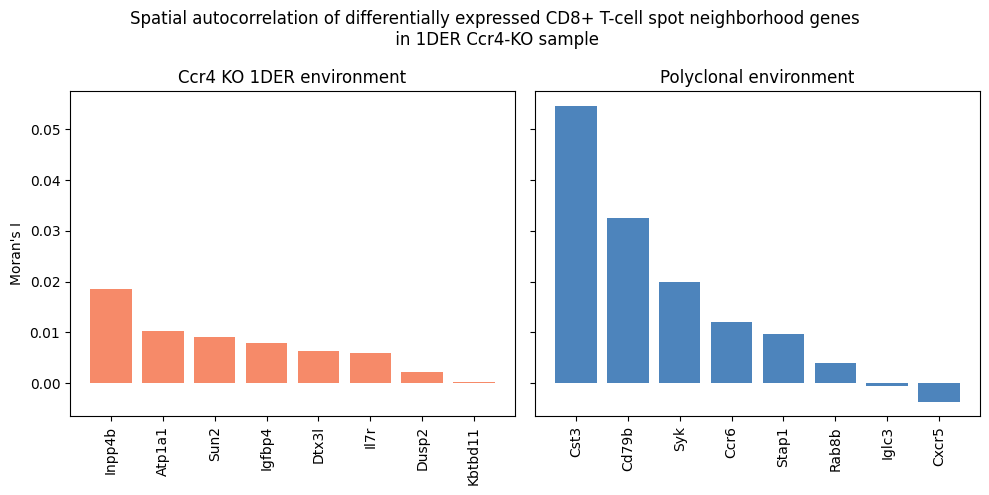

In [49]:
cd8_adata_ko = adata_ko[adata_ko.obs['cell_type'] == 'CD8+ T']

sq.gr.spatial_neighbors(cd8_adata_ko)
top_moran = sq.gr.spatial_autocorr(cd8_adata_ko, mode='moran', genes=top_genes, n_perms=100, copy=True)
bottom_moran = sq.gr.spatial_autocorr(cd8_adata_ko, mode='moran', genes=bottom_genes, n_perms=100, copy=True)

top_moran_I = top_moran['I'].values
bottom_moran_I = bottom_moran['I'].values

x = np.arange(len(top_moran.index))

fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

axs[0].bar(x, top_moran_I, color='#f46d43', alpha=0.8)
axs[0].set_xticks(x)
axs[0].set_xticklabels(top_moran.index, rotation=90)
axs[0].set_ylabel("Moran's I")
axs[0].set_title("Ccr4 KO 1DER environment")

axs[1].bar(x, bottom_moran_I, color='#2166ac', alpha=0.8)
axs[1].set_xticks(x)
axs[1].set_xticklabels(bottom_moran.index, rotation=90)
axs[1].set_title("Polyclonal environment")

plt.suptitle("Spatial autocorrelation of differentially expressed CD8+ T-cell spot neighborhood genes\n in 1DER Ccr4-KO sample")
plt.tight_layout()
plt.show()


/ix/djishnu/alw399/envs/bee/lib/python3.9/site-packages/squidpy/gr/_utils.py:194: ImplicitModificationWarning: Setting element `.obsp['spatial_connectivities']` of view, initializing view as actual.
  obj[key] = data


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

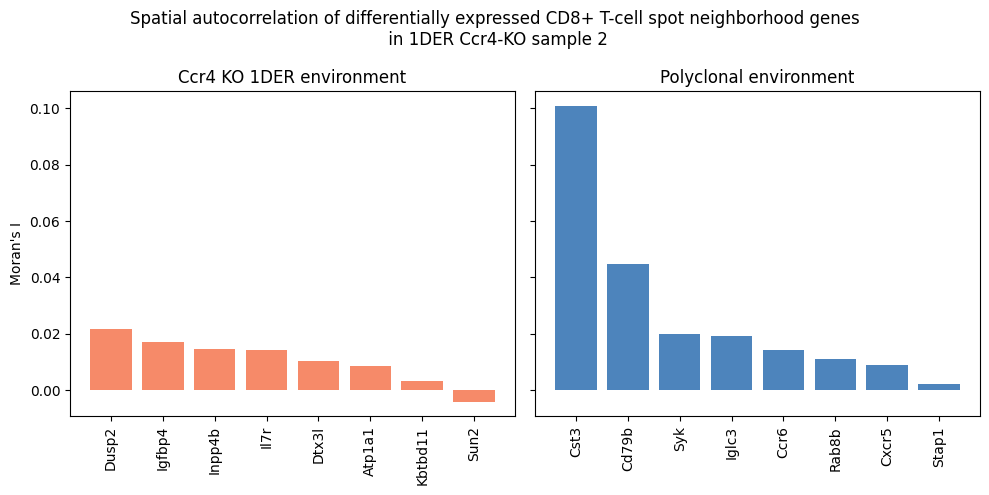

In [50]:
cd8_adata_ko2 = adata_ko2[adata_ko2.obs['cell_type'] == 'CD8+ T']

sq.gr.spatial_neighbors(cd8_adata_ko2)
top_moran = sq.gr.spatial_autocorr(cd8_adata_ko2, mode='moran', genes=top_genes, n_perms=100, copy=True)
bottom_moran = sq.gr.spatial_autocorr(cd8_adata_ko2, mode='moran', genes=bottom_genes, n_perms=100, copy=True)

top_moran_I = top_moran['I'].values
bottom_moran_I = bottom_moran['I'].values

x = np.arange(len(top_moran.index))

fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

axs[0].bar(x, top_moran_I, color='#f46d43', alpha=0.8)
axs[0].set_xticks(x)
axs[0].set_xticklabels(top_moran.index, rotation=90)
axs[0].set_ylabel("Moran's I")
axs[0].set_title("Ccr4 KO 1DER environment")

axs[1].bar(x, bottom_moran_I, color='#2166ac', alpha=0.8)
axs[1].set_xticks(x)
axs[1].set_xticklabels(bottom_moran.index, rotation=90)
axs[1].set_title("Polyclonal environment")

plt.suptitle("Spatial autocorrelation of differentially expressed CD8+ T-cell spot neighborhood genes\n in 1DER Ccr4-KO sample 2")
plt.tight_layout()
plt.show()


[<Axes: title={'center': 'Inpp4b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Il7r'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Kbtbd11'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Dusp2'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Dtx3l'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Igfbp4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Atp1a1'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Sun2'}, xlabel='spatial1', ylabel='spatial2'>]

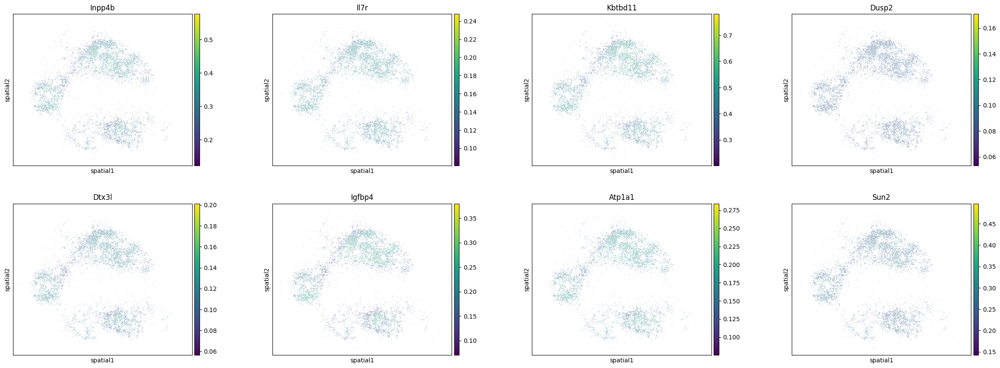

In [ ]:
sc.pl.spatial(adata_control[adata_control.obs['cell_type'] == 'CD8+ T'], color=top_genes, show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Cd79b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Syk'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cst3'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Iglc3'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Stap1'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Rab8b'}, xlabel='spatial1', ylabel='spatial2'>]

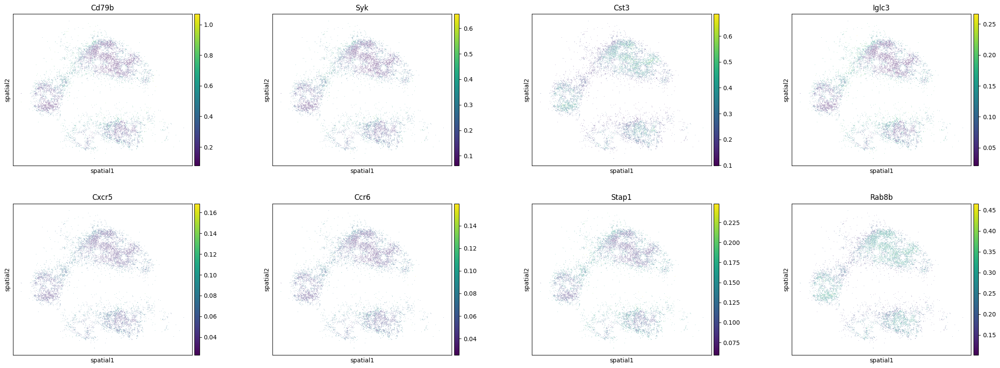

In [ ]:
sc.pl.spatial(adata_control[adata_control.obs['cell_type'] == 'CD8+ T'], color=bottom_genes, show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Ccr4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>]

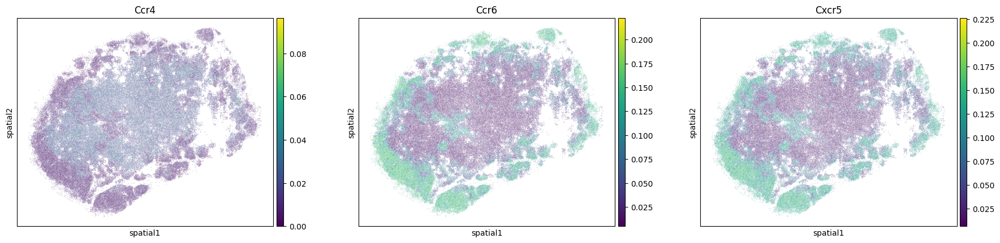

In [ ]:
sc.pl.spatial(adata_ko, color=['Ccr4', 'Ccr6', 'Cxcr5'], show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Cxcl13'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Il7r'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>]

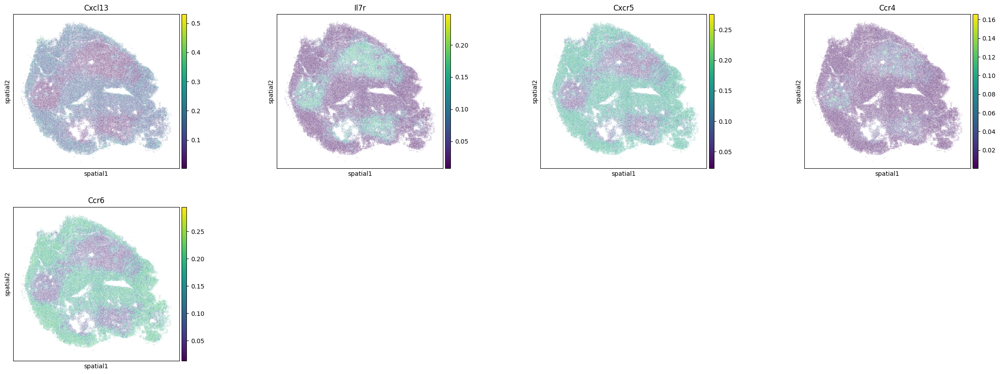

In [ ]:
sc.pl.spatial(adata_control, color=['Cxcl13', 'Il7r', 'Cxcr5', 'Ccr4', 'Ccr6'], show=False, spot_size=10, layer='imputed_count')

In [ ]:
from sklearn.preprocessing import StandardScaler

dfrvals = dfr.values

scaler = StandardScaler()
scaler.fit(dfrvals)
dfrvals = scaler.transform(dfrvals)

dfr = pd.DataFrame(dfrvals, index=dfr.index, columns=dfr.columns)

In [ ]:
from sklearn.cluster import KMeans

# KMeans clustering
n_clusters = 3
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(dfr.values)

# Baseline
gex = adata_control[dfr.index, :].to_df(layer='imputed_count')
scaler = StandardScaler()
gex = scaler.fit_transform(gex.values)
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters_gex = kmeans.fit_predict(gex)

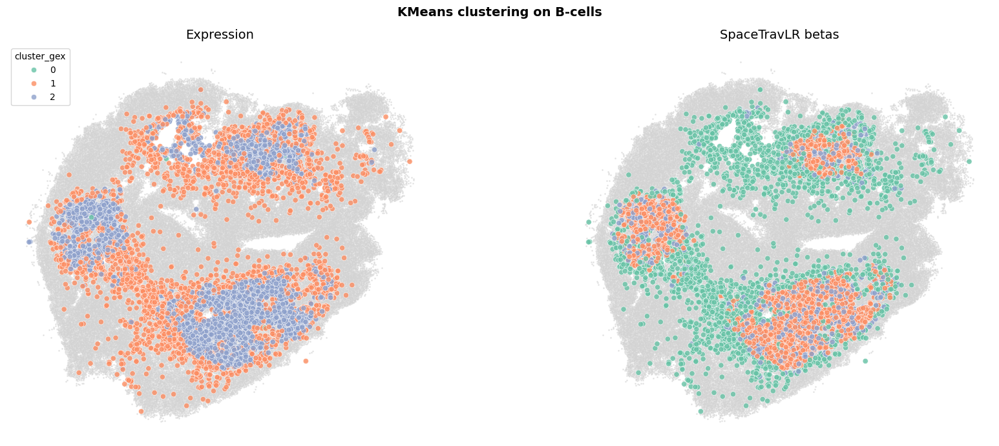

In [ ]:
embedding = adata_control[dfr.index, :].obsm['spatial']

fig, axs = plt.subplots(1, 2, figsize=(18,7))

plot_data = pd.DataFrame(
    {
        'x': embedding[:, 0],
        'y': embedding[:, 1],
        'cluster': clusters,
        'cluster_gex': clusters_gex
    }
)
plot_data['cluster'] = plot_data['cluster'].astype(str).astype('category')
plot_data['cluster_gex'] = plot_data['cluster_gex'].astype(str).astype('category')

axs[0].scatter(
    adata_control.obsm['spatial'][:, 0],
    adata_control.obsm['spatial'][:, 1],
    c='lightgray',
    s=1,
    alpha=0.5
)
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    hue='cluster_gex',
    palette='Set2',
    ax=axs[0],
    alpha=0.8
)

axs[1].scatter(
    adata_control.obsm['spatial'][:, 0],
    adata_control.obsm['spatial'][:, 1],
    c='lightgray',
    s=1,
    alpha=0.5
)
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    hue='cluster',
    palette='Set2',
    ax=axs[1],
    legend=False,
    alpha=0.8
)


axs[0].set_axis_off()
axs[0].set_aspect('equal')
axs[1].set_axis_off()
axs[1].set_aspect('equal')
axs[1].set_title('SpaceTravLR betas', fontsize=14)
axs[0].set_title('Expression', fontsize=14)
plt.suptitle('KMeans clustering on B-cells', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()


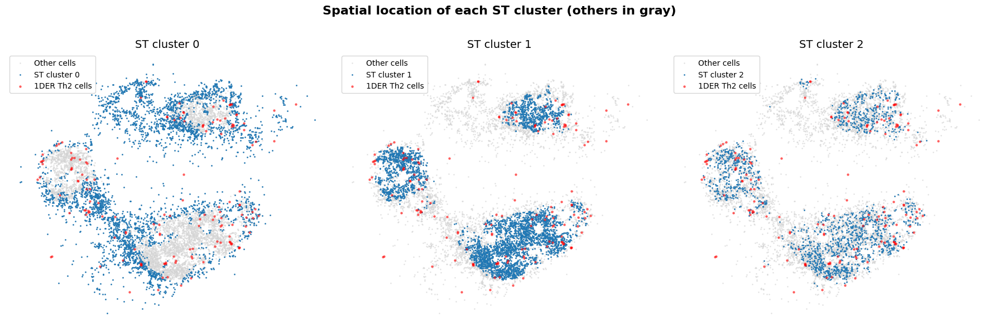

In [ ]:
# Plot each ST cluster on separate subplots, with all other cells in gray, arranged in one row

unique_st_clusters = plot_data['cluster'].cat.categories if hasattr(plot_data['cluster'], 'cat') else plot_data['cluster'].unique()
n_clusters = len(unique_st_clusters)
n_cols = n_clusters
n_rows = 1
fig, axs = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 6 * n_rows), squeeze=False)

for i, clust in enumerate(unique_st_clusters):
    ax = axs[0, i]
    ax.scatter(plot_data['x'], plot_data['y'], color='lightgray', s=1, label='Other cells', alpha=0.5)
    mask = plot_data['cluster'] == clust
    ax.scatter(plot_data.loc[mask, 'x'], plot_data.loc[mask, 'y'], 
               label=f'ST cluster {clust}', s=1, alpha=0.9)
    ax.scatter(
        adata_control[adata_control.obs['1DER_cell_type'] == '1DER Th2'].obsm['spatial'][:, 0], 
        adata_control[adata_control.obs['1DER_cell_type'] == '1DER Th2'].obsm['spatial'][:, 1], 
        color='red', s=5, label='1DER Th2 cells', alpha=0.5)
    ax.set_title(f'ST cluster {clust}', fontsize=14)
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.legend(loc='best')

# Hide any unused subplots (shouldn't be needed, but for safety)
for j in range(i + 1, n_rows * n_cols):
    axs[0, j].set_visible(False)

plt.subplots_adjust(top=0.85)  # Add padding to move up the suptitle
plt.suptitle('Spatial location of each ST cluster (others in gray)', fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()


In [40]:
# Plot each GEX cluster on separate subplots, with all other cells in gray

unique_gex_clusters = plot_data['cluster_gex'].cat.categories if hasattr(plot_data['cluster_gex'], 'cat') else plot_data['cluster_gex'].unique()
n_gex_clusters = len(unique_gex_clusters)
fig, axs = plt.subplots(1, n_gex_clusters, figsize=(6 * n_gex_clusters, 6), squeeze=False)

for i, clust in enumerate(unique_gex_clusters):
    ax = axs[0, i]
    # Plot all cells in gray
    ax.scatter(plot_data['x'], plot_data['y'], color='lightgray', s=1, label='Other cells', alpha=0.5)
    # Overlay cells in this GEX cluster
    mask = plot_data['cluster_gex'] == clust
    ax.scatter(plot_data.loc[mask, 'x'], plot_data.loc[mask, 'y'], 
               label=f'GEX cluster {clust}', s=1, alpha=0.9)
    ax.set_title(f'GEX cluster {clust}', fontsize=14)
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.legend(loc='best')

plt.suptitle('Spatial location of each GEX cluster (others in gray)', fontsize=16, fontweight='bold', y=1.02)

plt.tight_layout()
plt.show()


NameError: name 'plot_data' is not defined

In [41]:
import commot as ct 
from spaceoracle.tools.network import expand_paired_interactions

species = 'mouse'
df_ligrec = ct.pp.ligand_receptor_database(
    database='CellChat', 
    species=species, 
    signaling_type=None
) 
df_ligrec.columns = ['ligand', 'receptor', 'pathway', 'signaling']  

lr = expand_paired_interactions(df_ligrec)
lr = lr[lr.ligand.isin(adata.var_names) &\
    (lr.receptor.isin(adata.var_names))]
lr.head(3)


,ligand,receptor,pathway,signaling
0,Tgfb1,Tgfbr1,TGFb,Secreted Signaling
0,Tgfb1,Tgfbr2,TGFb,Secreted Signaling
2,Tgfb3,Tgfbr1,TGFb,Secreted Signaling


In [42]:
bottom

,names,scores_ko4_all,logfoldchanges_ko4_all,pvals_ko4_all,pvals_adj_ko4_all,scores_ko2_all,logfoldchanges_ko2_all,pvals_ko2_all,pvals_adj_ko2_all,scores_ko_all,scores_ko4_1der,logfoldchanges_ko4_1der,pvals_ko4_1der,pvals_adj_ko4_1der,scores_ko2_1der,logfoldchanges_ko2_1der,pvals_ko2_1der,pvals_adj_ko2_1der,scores_ko_1der,pvals_max
22,Cd79b,-6.054898,-1.582928,1.405069e-09,3.303474e-07,-6.786913,-1.985640,1.145583e-11,2.693394e-09,-12.841810,-4.407499,-1.882756,0.000010,0.002766,-4.798542,-2.158695,0.000002,0.000376,-9.206041,1.145583e-11
131,Syk,-3.655862,-1.500394,2.563192e-04,3.013175e-02,-2.740687,-1.209638,6.131095e-03,1.582121e-01,-6.396549,-2.521301,-1.837540,0.011692,1.000000,-1.706924,-1.317762,0.087836,1.000000,-4.228225,2.563192e-04
33,Cst3,-2.444762,-0.465645,1.449479e-02,8.071310e-01,1.738739,-0.016623,8.208069e-02,7.486325e-01,-0.706023,-1.990052,-0.544403,0.046585,1.000000,0.774966,-0.095431,0.438360,1.000000,-1.215087,1.449479e-02
65,Iglc3,-1.575162,-2.161049,1.152190e-01,1.000000e+00,-2.222993,-4.002290,2.621630e-02,3.962406e-01,-3.798155,-1.164049,-2.720417,0.244404,1.000000,-1.509587,-4.266655,0.131149,1.000000,-2.673636,2.621630e-02
34,Cxcr5,-1.855091,-2.919212,6.358319e-02,1.000000e+00,-0.832748,-1.212411,4.049868e-01,1.000000e+00,-2.687840,-1.449823,-3.404144,0.147108,1.000000,-0.988616,-1.544278,0.322851,1.000000,-2.438439,6.358319e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13,Bet1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.022567,-0.138073,0.981996,1.000000,0.048589,-0.301524,0.961247,1.000000,0.026022,9.612470e-01
23,Cdc42ep2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.046976,-21.107784,0.962532,1.000000,0.022628,-0.434765,0.981947,1.000000,-0.024348,9.625320e-01
86,Myh10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.040759,-0.126765,0.967488,1.000000,-0.008771,-0.981995,0.993002,1.000000,-0.049530,9.674880e-01
69,Isg20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.035463,-0.512566,0.971711,1.000000,0.035433,-0.677712,0.971734,1.000000,-0.000030,9.717108e-01


In [43]:
# correlation between CclX-Ccr4 interactions and 

In [44]:
cd8_adata.obs = cd8_adata.obs.join(pd.DataFrame(clusters, index=dfr.index).rename(columns={0: 'ST_cluster'}))
cd8_adata.obs = cd8_adata.obs.join(pd.DataFrame(clusters_gex, index=dfr.index).rename(columns={0: 'GEX_cluster'}))
cd8_adata.obs.head(3)

NameError: name 'clusters' is not defined

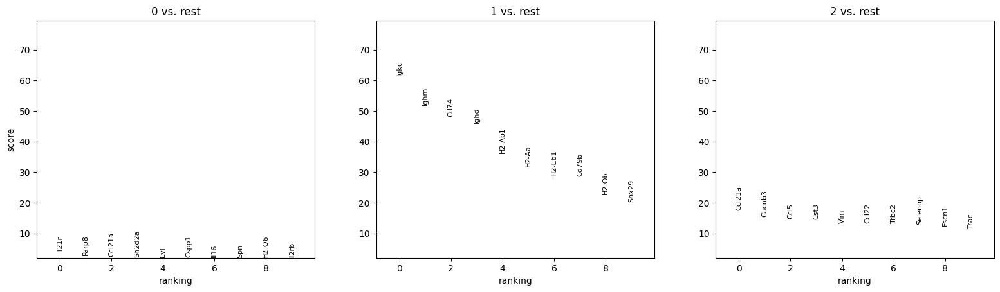

In [ ]:
cd8_adata.obs['GEX_cluster'] = cd8_adata.obs['GEX_cluster'].astype(str).astype('category')
cd8_adata.obs['ST_cluster'] = cd8_adata.obs['ST_cluster'].astype(str).astype('category')

degs = sc.tl.rank_genes_groups(cd8_adata, groupby='GEX_cluster', method='wilcoxon', layer='normalized_count', use_raw=False, copy=True)
sc.pl.rank_genes_groups(degs, n_genes=10, show=False)

In [45]:
degs = sc.tl.rank_genes_groups(cd8_adata, groupby='ST_cluster', method='wilcoxon', layer='normalized_count', use_raw=False, copy=True)
sc.pl.rank_genes_groups(degs, n_genes=10, show=False)

KeyError: 'ST_cluster'

In [ ]:
dfr.drop([x for x in dfr.columns if 'C3' in x], axis=1, inplace=True)
dfr_raw = dfr.copy()


In [ ]:
top_interactions = dfr.sum().sort_values(ascending=False).head(5)
top_interactions

Il16-Cd4        0.226257
Ccl21a-Ccr7     0.076925
Lgals9-Ptprc    0.031346
Ccl5-Ccr4       0.020027
Ccl22-Ccr4      0.015679
dtype: float64

In [ ]:
dfr = dfr/dfr.abs().max()

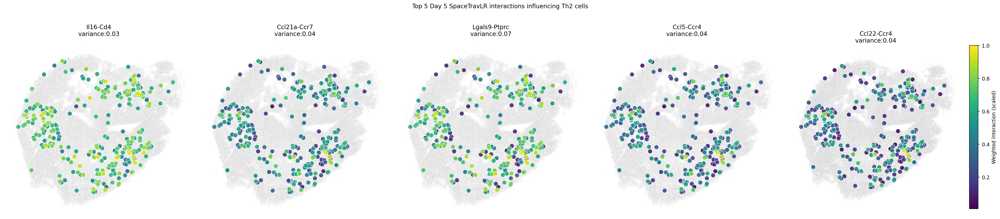

In [ ]:
n_plots = 5
fig, axs = plt.subplots(1, n_plots, figsize=(28, 6), dpi=200)
axs = axs.flatten()

plot_cols = list(top_interactions.index)[:n_plots]
cmap = 'viridis'

# Compute global vmin/vmax for all plotted columns
vmin = min(dfr[hue].min() for hue in plot_cols if hue in dfr.columns)
vmax = max(dfr[hue].max() for hue in plot_cols if hue in dfr.columns)
norm = plt.Normalize(vmin, vmax)

# Plot background clusters
for ax in axs:
    sns.scatterplot(
        x=adata.obsm['spatial'][:, 0],
        y=adata.obsm['spatial'][:, 1],
        color='gray',
        # hue=adata.obs['banksy_cluster'],
        # palette=color_dict,
        s=5,
        legend=False,
        ax=ax,
        alpha=0.03,
    )

for i, hue in enumerate(plot_cols):
    if hue in dfr.columns:

        hue_var = dfr[hue].var()

        sc = sns.scatterplot(
            data=dfr.sort_values(by=hue, ascending=True),
            x=adata[dfr.index, :].obsm['spatial'][:, 0],
            y=adata[dfr.index, :].obsm['spatial'][:, 1],
            hue=hue,
            palette=cmap,
            s=80,
            ax=axs[i],
            legend=False,
            hue_norm=norm,
            alpha=0.9
        )
        axs[i].set_aspect('equal')
        axs[i].set_axis_off()
        axs[i].set_title(f'{hue}\nvariance:{hue_var:.2f}')
    else:
        axs[i].set_visible(False)

# Hide any unused axes
for j in range(len(plot_cols), n_plots):
    axs[j].set_visible(False)

# Add one shared colorbar for all subplots
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(axs[-1])
cax = divider.append_axes("right", size="5%", pad=0.15)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cax, orientation='vertical')
cbar.set_label("Weighted interaction (scaled)")

plt.suptitle('Top 5 Day 5 SpaceTravLR interactions influencing Th2 cells', y=1.05)
plt.tight_layout()
plt.savefig('figures/mouse_lymph_visiumHD_top_Th2_LR_interactions.svg', dpi=300, bbox_inches='tight', transparent=True, format='svg')
plt.show()


In [ ]:
target_genes = ['Il16', 'Cd4', 'Ccl21a', 'Ccr7', 'Lgals9', 'Ptprc', 'Ccl5', 'Ccr4', 'Ccl22']

In [ ]:
import os 

betadir = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/'

data = {}
for gene in target_genes:
    dfs = []
    for sample in ['a', 'b', 'c', 'd']:
        fpath = os.path.join(betadir, f'mouse_lymph1{sample}_visiumHD', f'{gene}_betadata.parquet')
        if os.path.exists(fpath):
            dfs.append(pd.read_parquet(fpath))
    if dfs:
        data[gene] = pd.concat(dfs, axis=0)
len(data.keys())

8

In [ ]:
baseline = 'Ccl22-Ccr4'
corrs = dfr.corr()[baseline]
corrs

Il16-Cd4        0.444937
Ccl21a-Ccr7     0.871511
Lgals9-Ptprc    0.260598
Ccl5-Ccr4       0.982914
Ccl22-Ccr4      1.000000
Name: Ccl22-Ccr4, dtype: float64

In [ ]:
baseline = 'Ccl5-Ccr4'
corrs = dfr.corr()[baseline]
corrs

Il16-Cd4        0.467948
Ccl21a-Ccr7     0.871487
Lgals9-Ptprc    0.303093
Ccl5-Ccr4       1.000000
Ccl22-Ccr4      0.982914
Name: Ccl5-Ccr4, dtype: float64

In [25]:
import scanpy as sc 

In [ ]:
adata_sc = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/rctd_outputs/mouse_lymphnode_slideseq/zhongli_ref_202401203_mannually_woDoublet.h5ad')

sc.tl.rank_genes_groups(adata_sc, groupby="cell_type", use_raw=False)
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:1000, :]
markers = markers_df['CD8+ T'].values.flatten()
# markers = markers_df[['Th2','B']].values.flatten()
# markers = markers_df.values.flatten()
len(markers)

1000

In [27]:
# target_genes = ['Il2ra', 'Gata3', 'Il4']
target_genes = [x for x in markers if x in adata_control.var_names]
len(target_genes)

312

In [ ]:
import os 

betadir = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/'

data = {}
for gene in target_genes:
    dfs = []
    for sample in ['a', 'b', 'c', 'd']:
        fpath = os.path.join(betadir, f'mouse_lymph1{sample}_visiumHD', f'{gene}_betadata.parquet')
        if os.path.exists(fpath):
            dfs.append(pd.read_parquet(fpath))
    if dfs:
        data[gene] = pd.concat(dfs, axis=0)
len(data.keys())

303

In [29]:
adata = adata_control

In [30]:
interactions = {
    'Th2': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'Th2'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'Th2_transferred': {
        gene: data[gene].reindex(adata[(adata.obs['cell_type'] == 'Th2') & (adata.obs.index.isin(transferred))].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'Cd4': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'].isin(['Th2','Tfh'])].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    }, 
    'B': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'B'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'all': {
        gene: data[gene].reindex(adata.obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
    'CD8+ T': {
        gene: data[gene].reindex(adata[adata.obs['cell_type'] == 'CD8+ T'].obs.index, axis=0).fillna(0)
        for gene in data.keys()
    },
}

In [31]:
dfr = pd.concat([interactions['CD8+ T'][g] for g in set(markers_df['CD8+ T']) & set(data.keys())], axis=1).fillna(0)
dfr = dfr.groupby(dfr.columns, axis=1).mean()
# dfr = dfr[[x for x in dfr.columns if ('$' in x or '#' in x)]]
# dfr = dfr[[x for x in dfr.columns if ('$' in x)]]

dfr_ligands = [x.split('$')[0] if '$' in x else x.split('#')[0] if '#' in x else 'none' for x in dfr.columns]
dfr_ligands = [x.replace('beta_', '') for x in dfr_ligands]
dfr_genes = [x.split('$')[1] if '$' in x else x.split('#')[1] if '#' in x else 'none' for x in dfr.columns]

adata.uns['received_ligands']['none'] = 0 # for the beta_TF
adata.uns['cell_thresholds']['none'] = 0

ligands_expr = adata.uns['received_ligands'].loc[dfr.index, dfr_ligands]
ligands_expr = np.where(adata.uns['cell_thresholds'].loc[dfr.index, dfr_ligands] > 0, ligands_expr, 0)
receptors_expr = adata.to_df(layer='imputed_count').loc[dfr.index].reindex(dfr_genes, axis=1).fillna(0)
receptors_expr = np.where(adata.uns['cell_thresholds'].loc[dfr.index].reindex(dfr_genes, axis=1).fillna(0) > 0, receptors_expr, 0)

dfr = pd.DataFrame(
    dfr.values * ligands_expr * receptors_expr, 
    index=dfr.index, columns=dfr.columns
)
dfr.columns = [x.replace('$', '-').replace('beta_', '') for x in dfr.columns]


In [32]:
dfr = dfr.drop(columns=['beta0'], errors='ignore')
dfr = dfr[(dfr.var() > 1e-12).index]

In [33]:
import gc 
gc.collect()

41910

In [34]:
# b_control = adata.obs.index[(adata.obs['banksy_cluster'].isin(['T cell zone'])) & (adata.obs['cell_type'] == 'B')]
# dfr = dfr.loc[b_control, :]
# dfr.shape

In [ ]:
cd8_adata = adata_control[adata_control.obs['cell_type'] == 'CD8+ T']

sc.tl.score_genes(cd8_adata, gene_list=top_genes, score_name='top5_score', use_raw=False)
sc.tl.score_genes(cd8_adata, gene_list=bottom_genes, score_name='bottom5_score', use_raw=False)

sc.pl.spatial(cd8_adata, color=['top5_score', 'bottom5_score'], show=False, spot_size=20, layer='normalized_count', cmap='viridis')

NameError: name 'top_genes' is not defined

In [187]:
top_genes, bottom_genes

(['Inpp4b', 'Il7r', 'Kbtbd11', 'Dusp2', 'Dtx3l', 'Igfbp4', 'Atp1a1', 'Sun2'],
 ['Cd79b', 'Syk', 'Cst3', 'Iglc3', 'Cxcr5', 'Ccr6', 'Stap1', 'Rab8b'])

In [189]:
sq.gr.spatial_neighbors(cd8_adata)
top_moran = sq.gr.spatial_autocorr(cd8_adata, mode='moran', genes=top_genes, n_perms=100, copy=True)
bottom_moran = sq.gr.spatial_autocorr(cd8_adata, mode='moran', genes=bottom_genes, n_perms=100, copy=True)

  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

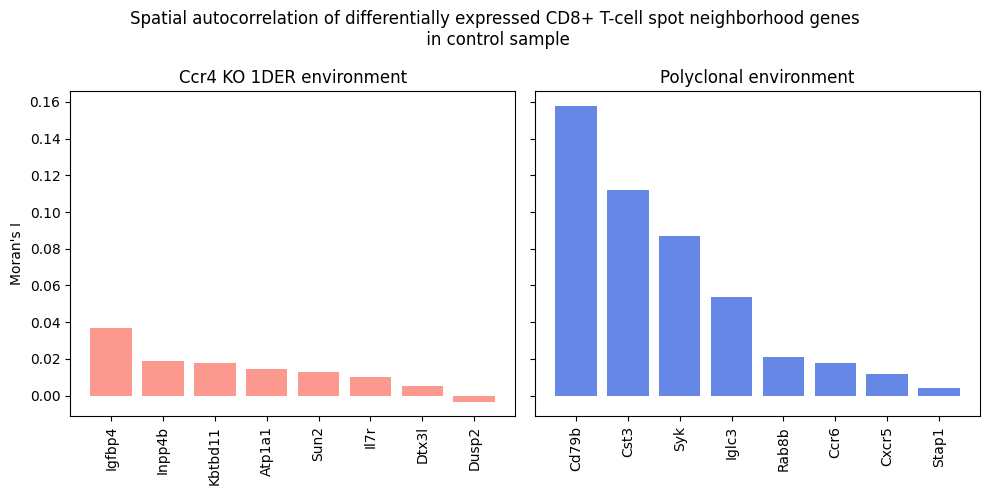

In [191]:
top_moran_I = top_moran['I'].values
bottom_moran_I = bottom_moran['I'].values

x = np.arange(len(genes))

fig, axs = plt.subplots(1, 2, figsize=(10, 5), sharey=True)

# Bar plot for top genes
axs[0].bar(x, top_moran_I, color='salmon', alpha=0.8)
axs[0].set_xticks(x)
axs[0].set_xticklabels(top_moran.index, rotation=90)
axs[0].set_ylabel("Moran's I")
axs[0].set_title("Ccr4 KO 1DER environment")

# Bar plot for bottom genes
axs[1].bar(x, bottom_moran_I, color='royalblue', alpha=0.8)
axs[1].set_xticks(x)
axs[1].set_xticklabels(bottom_moran.index, rotation=90)
axs[1].set_title("Polyclonal environment")

plt.suptitle("Spatial autocorrelation of differentially expressed CD8+ T-cell spot neighborhood genes\n in control sample")
plt.tight_layout()
plt.show()


[<Axes: title={'center': 'Inpp4b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Il7r'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Kbtbd11'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Dusp2'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Dtx3l'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Igfbp4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Atp1a1'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Sun2'}, xlabel='spatial1', ylabel='spatial2'>]

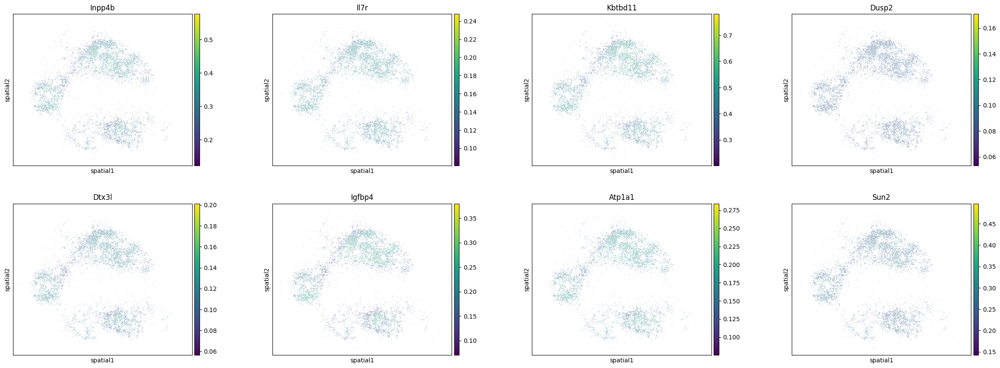

In [193]:
sc.pl.spatial(adata_control[adata_control.obs['cell_type'] == 'CD8+ T'], color=top_genes, show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Cd79b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Syk'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cst3'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Iglc3'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Stap1'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Rab8b'}, xlabel='spatial1', ylabel='spatial2'>]

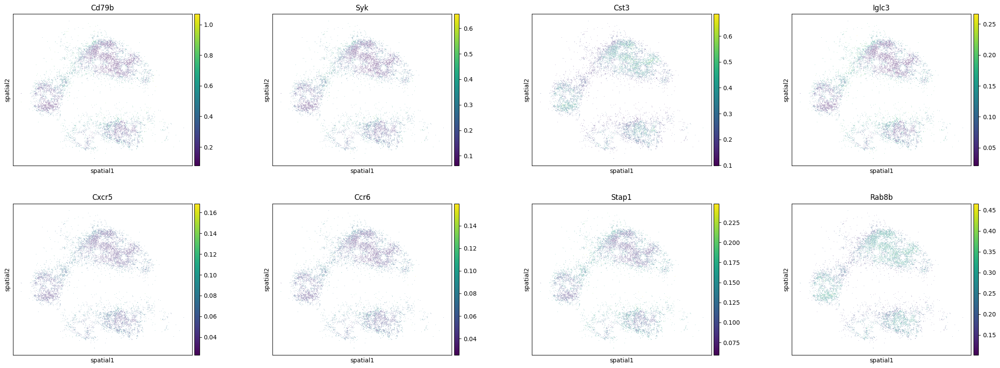

In [194]:
sc.pl.spatial(adata_control[adata_control.obs['cell_type'] == 'CD8+ T'], color=bottom_genes, show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Ccr4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>]

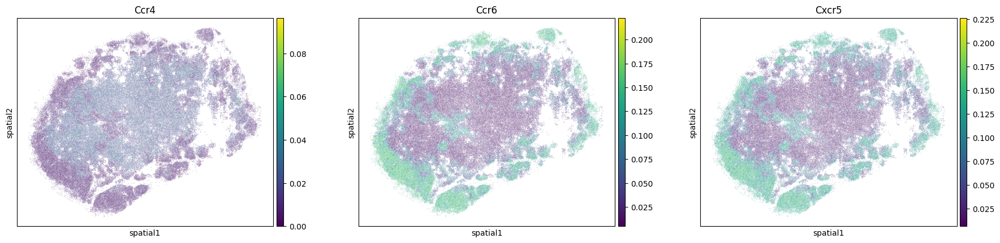

In [195]:
sc.pl.spatial(adata_ko, color=['Ccr4', 'Ccr6', 'Cxcr5'], show=False, spot_size=10, layer='imputed_count')

[<Axes: title={'center': 'Cxcl13'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Il7r'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Cxcr5'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'Ccr6'}, xlabel='spatial1', ylabel='spatial2'>]

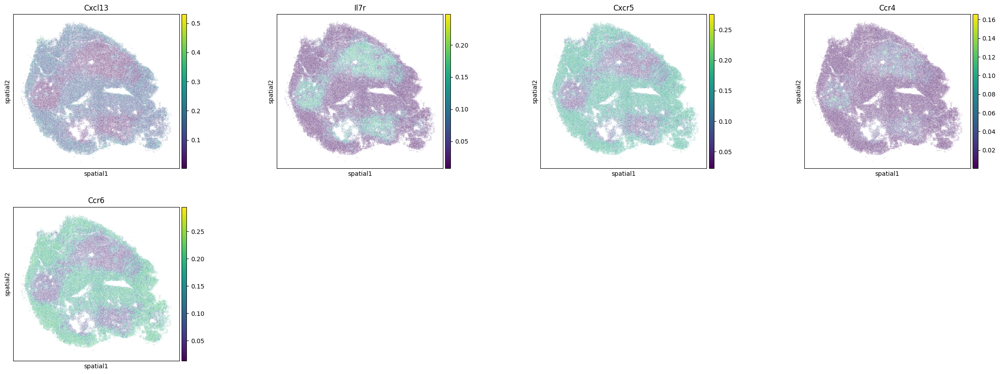

In [196]:
sc.pl.spatial(adata_control, color=['Cxcl13', 'Il7r', 'Cxcr5', 'Ccr4', 'Ccr6'], show=False, spot_size=10, layer='imputed_count')

In [234]:
from sklearn.preprocessing import StandardScaler

dfrvals = dfr.values

scaler = StandardScaler()
scaler.fit(dfrvals)
dfrvals = scaler.transform(dfrvals)

dfr = pd.DataFrame(dfrvals, index=dfr.index, columns=dfr.columns)

In [291]:
from sklearn.cluster import KMeans

# KMeans clustering
n_clusters = 3
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmeans.fit_predict(dfr.values)

# Baseline
gex = adata_control[dfr.index, :].to_df(layer='imputed_count')
scaler = StandardScaler()
gex = scaler.fit_transform(gex.values)
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
clusters_gex = kmeans.fit_predict(gex)

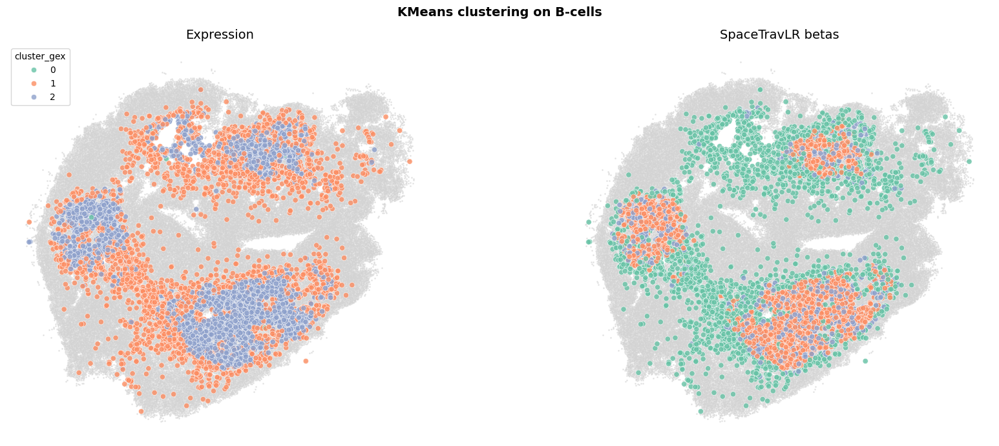

In [292]:
embedding = adata_control[dfr.index, :].obsm['spatial']

fig, axs = plt.subplots(1, 2, figsize=(18,7))

plot_data = pd.DataFrame(
    {
        'x': embedding[:, 0],
        'y': embedding[:, 1],
        'cluster': clusters,
        'cluster_gex': clusters_gex
    }
)
plot_data['cluster'] = plot_data['cluster'].astype(str).astype('category')
plot_data['cluster_gex'] = plot_data['cluster_gex'].astype(str).astype('category')

axs[0].scatter(
    adata_control.obsm['spatial'][:, 0],
    adata_control.obsm['spatial'][:, 1],
    c='lightgray',
    s=1,
    alpha=0.5
)
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    hue='cluster_gex',
    palette='Set2',
    ax=axs[0],
    alpha=0.8
)

axs[1].scatter(
    adata_control.obsm['spatial'][:, 0],
    adata_control.obsm['spatial'][:, 1],
    c='lightgray',
    s=1,
    alpha=0.5
)
sns.scatterplot(
    data=plot_data,
    x='x',
    y='y',
    hue='cluster',
    palette='Set2',
    ax=axs[1],
    legend=False,
    alpha=0.8
)


axs[0].set_axis_off()
axs[0].set_aspect('equal')
axs[1].set_axis_off()
axs[1].set_aspect('equal')
axs[1].set_title('SpaceTravLR betas', fontsize=14)
axs[0].set_title('Expression', fontsize=14)
plt.suptitle('KMeans clustering on B-cells', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()


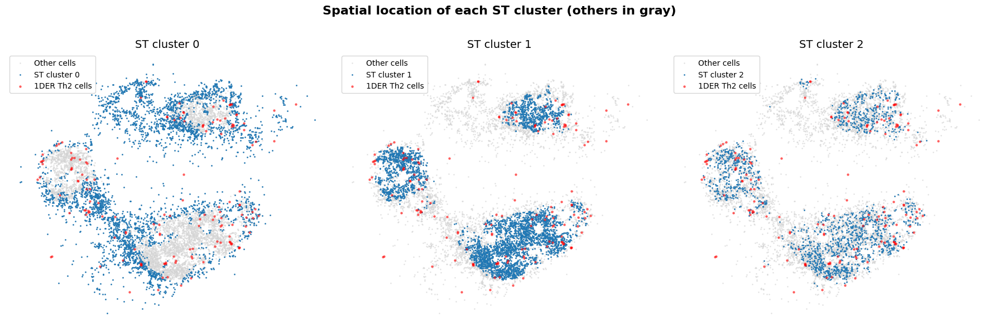

In [293]:
# Plot each ST cluster on separate subplots, with all other cells in gray, arranged in one row

unique_st_clusters = plot_data['cluster'].cat.categories if hasattr(plot_data['cluster'], 'cat') else plot_data['cluster'].unique()
n_clusters = len(unique_st_clusters)
n_cols = n_clusters
n_rows = 1
fig, axs = plt.subplots(n_rows, n_cols, figsize=(6 * n_cols, 6 * n_rows), squeeze=False)

for i, clust in enumerate(unique_st_clusters):
    ax = axs[0, i]
    ax.scatter(plot_data['x'], plot_data['y'], color='lightgray', s=1, label='Other cells', alpha=0.5)
    mask = plot_data['cluster'] == clust
    ax.scatter(plot_data.loc[mask, 'x'], plot_data.loc[mask, 'y'], 
               label=f'ST cluster {clust}', s=1, alpha=0.9)
    ax.scatter(
        adata_control[adata_control.obs['1DER_cell_type'] == '1DER Th2'].obsm['spatial'][:, 0], 
        adata_control[adata_control.obs['1DER_cell_type'] == '1DER Th2'].obsm['spatial'][:, 1], 
        color='red', s=5, label='1DER Th2 cells', alpha=0.5)
    ax.set_title(f'ST cluster {clust}', fontsize=14)
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.legend(loc='best')

# Hide any unused subplots (shouldn't be needed, but for safety)
for j in range(i + 1, n_rows * n_cols):
    axs[0, j].set_visible(False)

plt.subplots_adjust(top=0.85)  # Add padding to move up the suptitle
plt.suptitle('Spatial location of each ST cluster (others in gray)', fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()


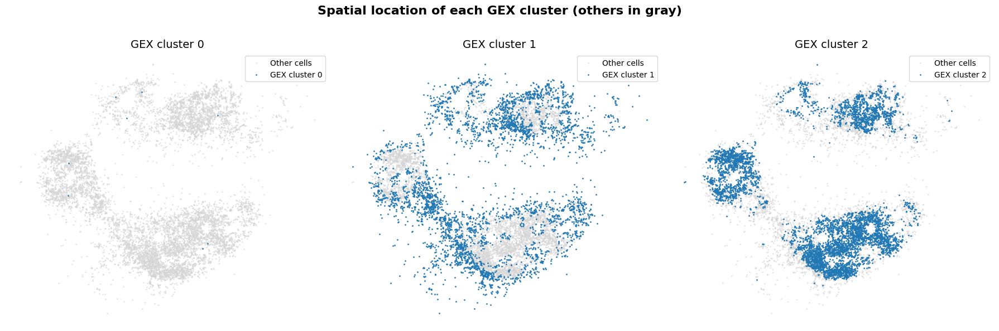

In [294]:
# Plot each GEX cluster on separate subplots, with all other cells in gray

unique_gex_clusters = plot_data['cluster_gex'].cat.categories if hasattr(plot_data['cluster_gex'], 'cat') else plot_data['cluster_gex'].unique()
n_gex_clusters = len(unique_gex_clusters)
fig, axs = plt.subplots(1, n_gex_clusters, figsize=(6 * n_gex_clusters, 6), squeeze=False)

for i, clust in enumerate(unique_gex_clusters):
    ax = axs[0, i]
    # Plot all cells in gray
    ax.scatter(plot_data['x'], plot_data['y'], color='lightgray', s=1, label='Other cells', alpha=0.5)
    # Overlay cells in this GEX cluster
    mask = plot_data['cluster_gex'] == clust
    ax.scatter(plot_data.loc[mask, 'x'], plot_data.loc[mask, 'y'], 
               label=f'GEX cluster {clust}', s=1, alpha=0.9)
    ax.set_title(f'GEX cluster {clust}', fontsize=14)
    ax.set_axis_off()
    ax.set_aspect('equal')
    ax.legend(loc='best')

plt.suptitle('Spatial location of each GEX cluster (others in gray)', fontsize=16, fontweight='bold', y=1.02)

plt.tight_layout()
plt.show()


In [332]:
import commot as ct 
from spaceoracle.tools.network import expand_paired_interactions

species = 'mouse'
df_ligrec = ct.pp.ligand_receptor_database(
    database='CellChat', 
    species=species, 
    signaling_type=None
) 
df_ligrec.columns = ['ligand', 'receptor', 'pathway', 'signaling']  

lr = expand_paired_interactions(df_ligrec)
lr = lr[lr.ligand.isin(adata.var_names) &\
    (lr.receptor.isin(adata.var_names))]
lr.head(3)


,ligand,receptor,pathway,signaling
0,Tgfb1,Tgfbr1,TGFb,Secreted Signaling
0,Tgfb1,Tgfbr2,TGFb,Secreted Signaling
2,Tgfb3,Tgfbr1,TGFb,Secreted Signaling


In [350]:
bottom

,names,scores_ko4_all,logfoldchanges_ko4_all,pvals_ko4_all,pvals_adj_ko4_all,scores_ko2_all,logfoldchanges_ko2_all,pvals_ko2_all,pvals_adj_ko2_all,scores_ko_all,scores_ko4_1der,logfoldchanges_ko4_1der,pvals_ko4_1der,pvals_adj_ko4_1der,scores_ko2_1der,logfoldchanges_ko2_1der,pvals_ko2_1der,pvals_adj_ko2_1der,scores_ko_1der,pvals_max
22,Cd79b,-6.054898,-1.582928,1.405069e-09,3.303474e-07,-6.786913,-1.985640,1.145583e-11,2.693394e-09,-12.841810,-4.407499,-1.882756,0.000010,0.002766,-4.798542,-2.158695,0.000002,0.000376,-9.206041,1.145583e-11
131,Syk,-3.655862,-1.500394,2.563192e-04,3.013175e-02,-2.740687,-1.209638,6.131095e-03,1.582121e-01,-6.396549,-2.521301,-1.837540,0.011692,1.000000,-1.706924,-1.317762,0.087836,1.000000,-4.228225,2.563192e-04
33,Cst3,-2.444762,-0.465645,1.449479e-02,8.071310e-01,1.738739,-0.016623,8.208069e-02,7.486325e-01,-0.706023,-1.990052,-0.544403,0.046585,1.000000,0.774966,-0.095431,0.438360,1.000000,-1.215087,1.449479e-02
65,Iglc3,-1.575162,-2.161049,1.152190e-01,1.000000e+00,-2.222993,-4.002290,2.621630e-02,3.962406e-01,-3.798155,-1.164049,-2.720417,0.244404,1.000000,-1.509587,-4.266655,0.131149,1.000000,-2.673636,2.621630e-02
34,Cxcr5,-1.855091,-2.919212,6.358319e-02,1.000000e+00,-0.832748,-1.212411,4.049868e-01,1.000000e+00,-2.687840,-1.449823,-3.404144,0.147108,1.000000,-0.988616,-1.544278,0.322851,1.000000,-2.438439,6.358319e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13,Bet1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.022567,-0.138073,0.981996,1.000000,0.048589,-0.301524,0.961247,1.000000,0.026022,9.612470e-01
23,Cdc42ep2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.046976,-21.107784,0.962532,1.000000,0.022628,-0.434765,0.981947,1.000000,-0.024348,9.625320e-01
86,Myh10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.040759,-0.126765,0.967488,1.000000,-0.008771,-0.981995,0.993002,1.000000,-0.049530,9.674880e-01
69,Isg20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.035463,-0.512566,0.971711,1.000000,0.035433,-0.677712,0.971734,1.000000,-0.000030,9.717108e-01


In [351]:
# correlation between CclX-Ccr4 interactions and 

['Alcam-Cd6',
 'Arid3b',
 'Ccl12#Nfe2l2',
 'Ccl17-Ccr4',
 'Cd6-Alcam',
 'Clec2d-Klrb1b',
 'Csf1-Csf1r',
 'Cxcl13-Cxcr5',
 'Ebi3#Arid3b',
 'Fasl-Fas',
 'Gdf11#Sox4',
 'H2-DMb1-Cd4',
 'H2-Q2-Cd8b1',
 'Hspg2-Dag1',
 'Il21#Jun',
 'Il21#Nfe2l2',
 'Il34-Csf1r',
 'Il4#Nfe2l2',
 'Il4#Sox4',
 'Jun',
 'Lamc1-Cd44',
 'Lamc1-Dag1',
 'Lamc1-Itga1',
 'Lamc1-Itga2',
 'Lamc1-Itga6',
 'Lamc1-Itga9',
 'Lamc1-Itgav',
 'Lamc1-Itgb1',
 'Lif#Nfe2l2',
 'Lta-Tnfrsf1a',
 'Lta-Tnfrsf1b',
 'Nfe2l2',
 'Sema4a-Nrp1',
 'Sema4d-Cd72',
 'Sox4',
 'Tgfb1#Jun',
 'Tgfb1#Sox4',
 'Tgfb1#Zfp524',
 'Tnf#Jun',
 'Tnf-Tnfrsf1a',
 'Tnf-Tnfrsf1b',
 'Zfp524']

In [327]:
cd8_adata.obs = cd8_adata.obs.join(pd.DataFrame(clusters, index=dfr.index).rename(columns={0: 'ST_cluster'}))
cd8_adata.obs = cd8_adata.obs.join(pd.DataFrame(clusters_gex, index=dfr.index).rename(columns={0: 'GEX_cluster'}))
cd8_adata.obs.head(3)

,sample,cell_type,secondary_annot,cell_type_int,x_umap,y_umap,banksy_cluster,tissue,1DER_cell_type,top5_score,bottom5_score,ST_cluster,GEX_cluster
object_id,,,,,,,,,,,,,
200373,unmatched,CD8+ T,Tfh,1,7.992571,-1.810663,T cell zone,lymph1,1DER NA,0.126911,-0.064071,1,2
169261,unmatched,CD8+ T,Resting T,1,7.608244,-1.636850,T cell zone,lymph1,1DER NA,0.026046,0.013465,2,2
198270,unmatched,CD8+ T,NaN,1,8.543650,-0.335735,T cell zone,lymph1,1DER NA,-0.014878,-0.189550,1,2


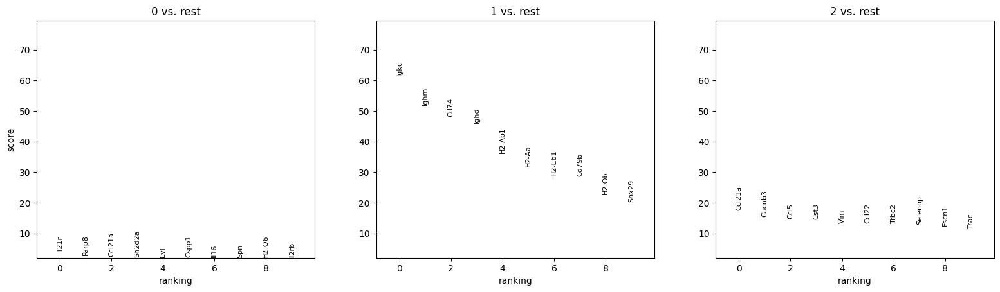

In [ ]:
cd8_adata.obs['GEX_cluster'] = cd8_adata.obs['GEX_cluster'].astype(str).astype('category')
cd8_adata.obs['ST_cluster'] = cd8_adata.obs['ST_cluster'].astype(str).astype('category')

degs = sc.tl.rank_genes_groups(cd8_adata, groupby='GEX_cluster', method='wilcoxon', layer='normalized_count', use_raw=False, copy=True)
sc.pl.rank_genes_groups(degs, n_genes=10, show=False)

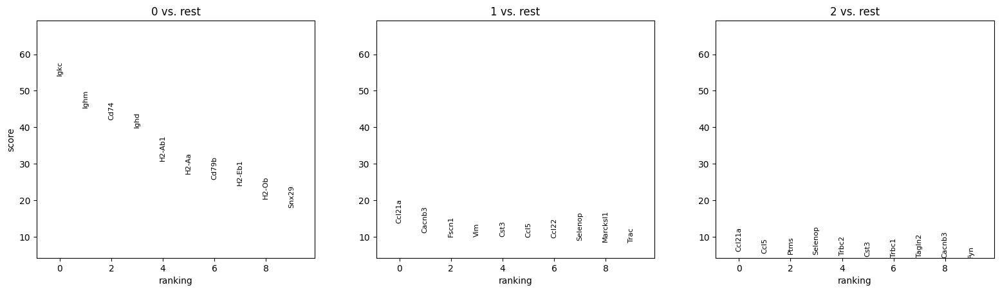

In [330]:
degs = sc.tl.rank_genes_groups(cd8_adata, groupby='ST_cluster', method='wilcoxon', layer='normalized_count', use_raw=False, copy=True)
sc.pl.rank_genes_groups(degs, n_genes=10, show=False)

In [30]:
dfr.drop([x for x in dfr.columns if 'C3' in x], axis=1, inplace=True)
dfr_raw = dfr.copy()


In [31]:
top_interactions = dfr.sum().sort_values(ascending=False).head(5)
top_interactions

Il16-Cd4        0.226257
Ccl21a-Ccr7     0.076925
Lgals9-Ptprc    0.031346
Ccl5-Ccr4       0.020027
Ccl22-Ccr4      0.015679
dtype: float64

In [32]:
dfr = dfr/dfr.abs().max()

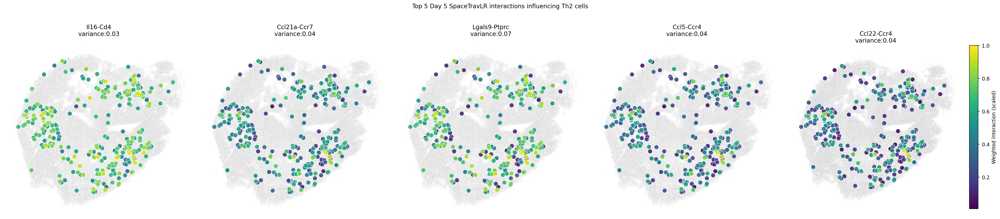

In [33]:
n_plots = 5
fig, axs = plt.subplots(1, n_plots, figsize=(28, 6), dpi=200)
axs = axs.flatten()

plot_cols = list(top_interactions.index)[:n_plots]
cmap = 'viridis'

# Compute global vmin/vmax for all plotted columns
vmin = min(dfr[hue].min() for hue in plot_cols if hue in dfr.columns)
vmax = max(dfr[hue].max() for hue in plot_cols if hue in dfr.columns)
norm = plt.Normalize(vmin, vmax)

# Plot background clusters
for ax in axs:
    sns.scatterplot(
        x=adata.obsm['spatial'][:, 0],
        y=adata.obsm['spatial'][:, 1],
        color='gray',
        # hue=adata.obs['banksy_cluster'],
        # palette=color_dict,
        s=5,
        legend=False,
        ax=ax,
        alpha=0.03,
    )

for i, hue in enumerate(plot_cols):
    if hue in dfr.columns:

        hue_var = dfr[hue].var()

        sc = sns.scatterplot(
            data=dfr.sort_values(by=hue, ascending=True),
            x=adata[dfr.index, :].obsm['spatial'][:, 0],
            y=adata[dfr.index, :].obsm['spatial'][:, 1],
            hue=hue,
            palette=cmap,
            s=80,
            ax=axs[i],
            legend=False,
            hue_norm=norm,
            alpha=0.9
        )
        axs[i].set_aspect('equal')
        axs[i].set_axis_off()
        axs[i].set_title(f'{hue}\nvariance:{hue_var:.2f}')
    else:
        axs[i].set_visible(False)

# Hide any unused axes
for j in range(len(plot_cols), n_plots):
    axs[j].set_visible(False)

# Add one shared colorbar for all subplots
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(axs[-1])
cax = divider.append_axes("right", size="5%", pad=0.15)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, cax=cax, orientation='vertical')
cbar.set_label("Weighted interaction (scaled)")

plt.suptitle('Top 5 Day 5 SpaceTravLR interactions influencing Th2 cells', y=1.05)
plt.tight_layout()
plt.savefig('figures/mouse_lymph_visiumHD_top_Th2_LR_interactions.svg', dpi=300, bbox_inches='tight', transparent=True, format='svg')
plt.show()


In [102]:
target_genes = ['Il16', 'Cd4', 'Ccl21a', 'Ccr7', 'Lgals9', 'Ptprc', 'Ccl5', 'Ccr4', 'Ccl22']

In [103]:
import os 

betadir = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/'

data = {}
for gene in target_genes:
    dfs = []
    for sample in ['a', 'b', 'c', 'd']:
        fpath = os.path.join(betadir, f'mouse_lymph1{sample}_visiumHD', f'{gene}_betadata.parquet')
        if os.path.exists(fpath):
            dfs.append(pd.read_parquet(fpath))
    if dfs:
        data[gene] = pd.concat(dfs, axis=0)
len(data.keys())

8

In [98]:
baseline = 'Ccl22-Ccr4'
corrs = dfr.corr()[baseline]
corrs

Il16-Cd4        0.444937
Ccl21a-Ccr7     0.871511
Lgals9-Ptprc    0.260598
Ccl5-Ccr4       0.982914
Ccl22-Ccr4      1.000000
Name: Ccl22-Ccr4, dtype: float64

In [116]:
baseline = 'Ccl5-Ccr4'
corrs = dfr.corr()[baseline]
corrs

Il16-Cd4        0.467948
Ccl21a-Ccr7     0.871487
Lgals9-Ptprc    0.303093
Ccl5-Ccr4       1.000000
Ccl22-Ccr4      0.982914
Name: Ccl5-Ccr4, dtype: float64